# GAN
___


In this notebook we'll create GAN model to generate images with cats.

Based on the [TDS post](https://towardsdatascience.com/getting-started-with-gans-using-pytorch-78e7c22a14a5)

## Plan

1. Load data
2. Preprocess data
3. Create two models - Generator and Discriminator
4. Organize loss calculation
5. Generate cats!
6. Repeat for human faces!

## Import libraries

In [1]:
import os
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torch
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
import torch.nn.functional as F
from torchvision.utils import save_image
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
%matplotlib inline

## Load data

In [ ]:
!wget https://www.dropbox.com/s/329oy3cprlvn5vb/archive.zip

--2021-05-04 09:34:51--  https://www.dropbox.com/s/329oy3cprlvn5vb/archive.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.6.18, 2620:100:601c:18::a27d:612
Connecting to www.dropbox.com (www.dropbox.com)|162.125.6.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/329oy3cprlvn5vb/archive.zip [following]
--2021-05-04 09:34:51--  https://www.dropbox.com/s/raw/329oy3cprlvn5vb/archive.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc2fa7c72891ad64952bc290fedc.dl.dropboxusercontent.com/cd/0/inline/BN2edSVlY0RDmFa59r2-ycrnTiD4wwA5m3ivG1rURgPqeKh5LG7KDIY0rWEpCulR4KErspfg_uBNVPDz6aYiS9nNrM24ECxcgvU3lVHD5asmYOM1NvGShX_PfAUjcTZHVhbSCfydWqy41SjheL4DmV-3/file# [following]
--2021-05-04 09:34:52--  https://uc2fa7c72891ad64952bc290fedc.dl.dropboxusercontent.com/cd/0/inline/BN2edSVlY0RDmFa59r2-ycrnTiD4wwA5m3ivG1rURgPqeKh5LG7KDIY0rWEpCulR4KErspfg_uBNVPDz6aYiS9nNrM24E

In [ ]:
from zipfile import ZipFile

with ZipFile('archive.zip', 'r') as zipObj:
   # Extract all the contents of zip file in current directory
   zipObj.extractall()

In [ ]:
DATA_DIR = './cats/'

## Preprocess data

Before training the model images have to be preprocessed:

1. The colors should be normalized (all RGB layers)
2. Images have to be sampled as batches

In [ ]:
# set parameters of the transformed data
image_size = 64
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

In [ ]:
# As dataset is stored in the directory, we can create dataset
# as ImageFolder PyTorch object and set all the transformations here
train_ds = ImageFolder(DATA_DIR, transform=tt.Compose([
    tt.ToTensor(),
    tt.Normalize(*stats)]))

In [ ]:
# Create PyTorch DataLoader object to produce batches
train_dl = DataLoader(train_ds, batch_size, shuffle=True, num_workers=2, pin_memory=True)

## Visualization functions

In [2]:
# for the nicer images visualization 
# we make inverse transformation for normalization
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

In [3]:
# functions to plot images
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break

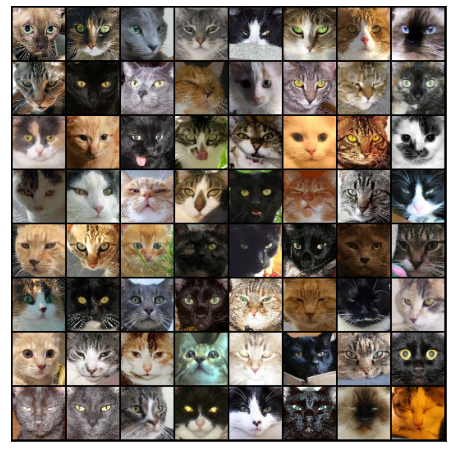

In [ ]:
show_batch(train_dl)

## Create models

**Discriminator** - model to classify images as real and generated. 

*Note*: Start simple. A few convolutions & batch normalization would do, inception/resnet is an overkill. Too smart discriminator hardly can be fooled by a generator, so the training can be overcomplicated.

**Generator** - decoder producing images from the vector of normal distribution.

*Note*: use ConvTranspose layers as inversion of usual convolutions.






In [4]:
# Utils functions for GPU usage of neural networks
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [ ]:
device = get_default_device()
device

device(type='cuda')

In [ ]:
train_dl = DeviceDataLoader(train_dl, device)

In [ ]:
discriminator = nn.Sequential(
    # in: 3 x 64 x 64

    nn.Conv2d(in_channels = 3, out_channels = 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid())

In [ ]:
discriminator = to_device(discriminator, device)

In [ ]:
latent_size = 128

In [ ]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 64 x 64
)

torch.Size([128, 3, 64, 64])


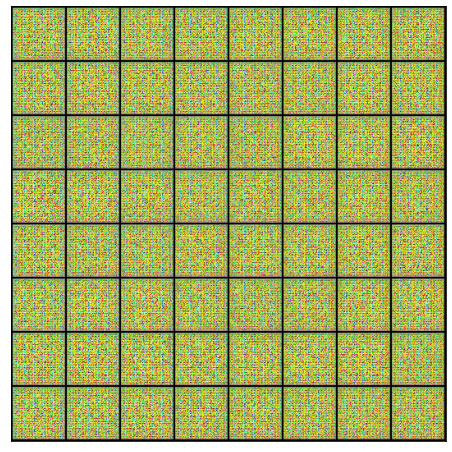

In [ ]:
xb = torch.randn(batch_size, latent_size, 1, 1) # random latent tensors
fake_images = generator(xb)
print(fake_images.shape)
show_images(fake_images)

In [ ]:
generator = to_device(generator, device)

In [ ]:
def train_discriminator(real_images, opt_d):
    # Clear discriminator gradients
    opt_d.zero_grad()

    # Pass real images through discriminator
    real_preds = discriminator(real_images)
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Pass fake images through discriminator
    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    # Update discriminator weights
    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()
    return loss.item(), real_score, fake_score

In [ ]:
def train_generator(opt_g):
    # Clear generator gradients
    opt_g.zero_grad()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)
    
    # Try to fool the discriminator
    preds = discriminator(fake_images)
    targets = torch.ones(batch_size, 1, device=device)
    loss = F.binary_cross_entropy(preds, targets)
    
    # Update generator weights
    loss.backward()
    opt_g.step()
    
    return loss.item()

In [ ]:
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

In [ ]:
def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(denorm(fake_images).cpu().detach(), nrow=8).permute(1, 2, 0))
        plt.show()

In [ ]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

Saving generated-images-0000.png


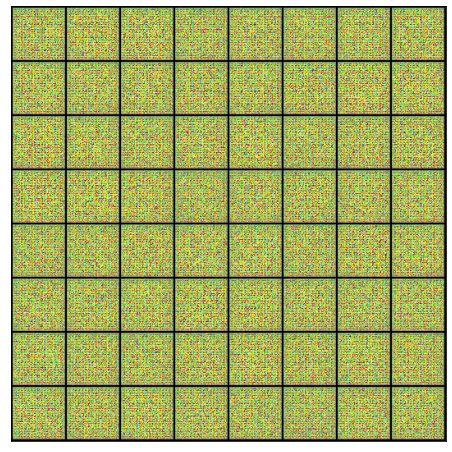

In [ ]:
save_samples(0, fixed_latent)

In [ ]:
def fit(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    # Create optimizers
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
    
    for epoch in range(epochs):
        for real_images, _ in tqdm(train_dl):
            # Train discriminator
            loss_d, real_score, fake_score = train_discriminator(real_images, opt_d)
            # Train generator
            loss_g = train_generator(opt_g)
            
        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))
    
        # Save generated images
        save_samples(epoch+start_idx, fixed_latent, show=True)
    
    return losses_g, losses_d, real_scores, fake_scores

In [ ]:
lr = 0.0002
epochs = 60


Epoch [1/60], loss_g: 8.8699, loss_d: 1.0665, real_score: 0.7299, fake_score: 0.4886
Saving generated-images-0001.png


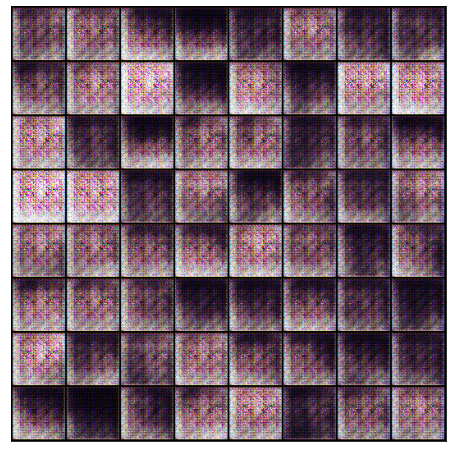


Epoch [2/60], loss_g: 4.1049, loss_d: 0.9888, real_score: 0.4343, fake_score: 0.0056
Saving generated-images-0002.png


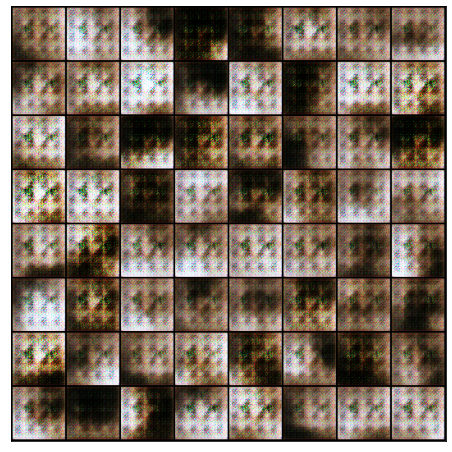


Epoch [3/60], loss_g: 3.8310, loss_d: 1.0379, real_score: 0.6845, fake_score: 0.3807
Saving generated-images-0003.png


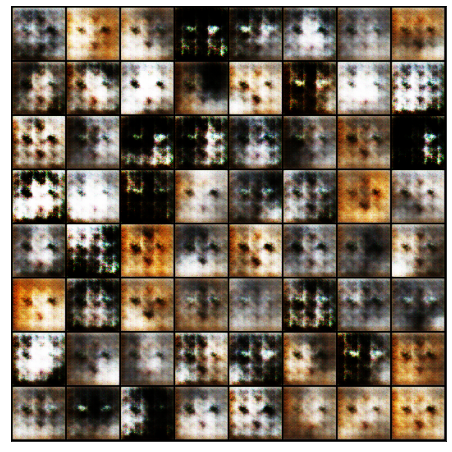


Epoch [4/60], loss_g: 5.4438, loss_d: 0.6420, real_score: 0.8973, fake_score: 0.3525
Saving generated-images-0004.png


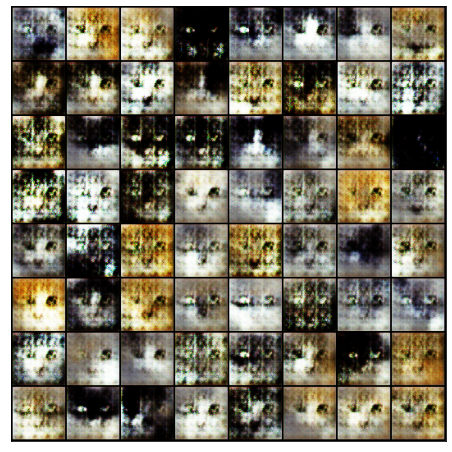


Epoch [5/60], loss_g: 5.3596, loss_d: 1.8133, real_score: 0.9557, fake_score: 0.7744
Saving generated-images-0005.png


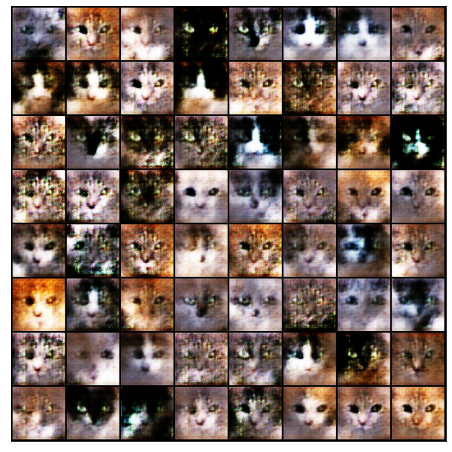


Epoch [6/60], loss_g: 7.9112, loss_d: 0.9887, real_score: 0.9520, fake_score: 0.5314
Saving generated-images-0006.png


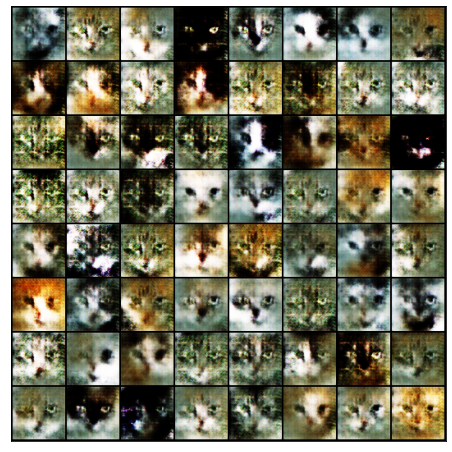


Epoch [7/60], loss_g: 6.7462, loss_d: 1.2380, real_score: 0.9900, fake_score: 0.6581
Saving generated-images-0007.png


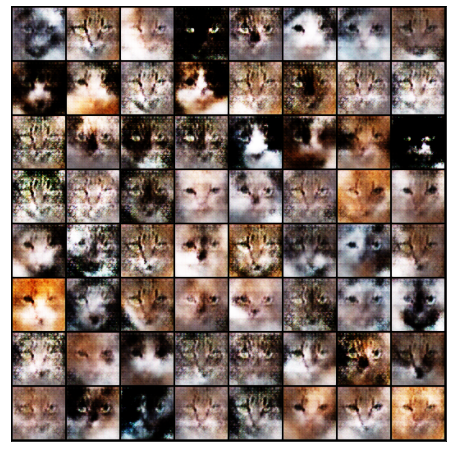


Epoch [8/60], loss_g: 2.9757, loss_d: 0.4346, real_score: 0.8000, fake_score: 0.1729
Saving generated-images-0008.png


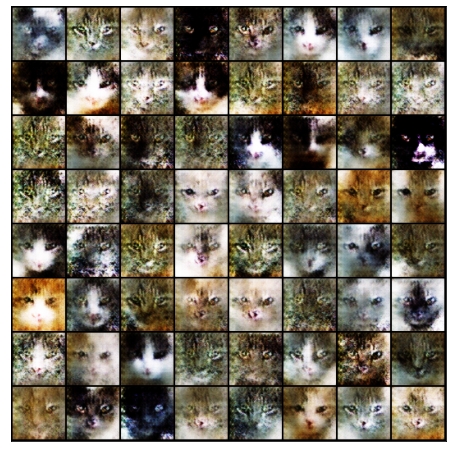


Epoch [9/60], loss_g: 1.1866, loss_d: 1.6105, real_score: 0.3944, fake_score: 0.1495
Saving generated-images-0009.png


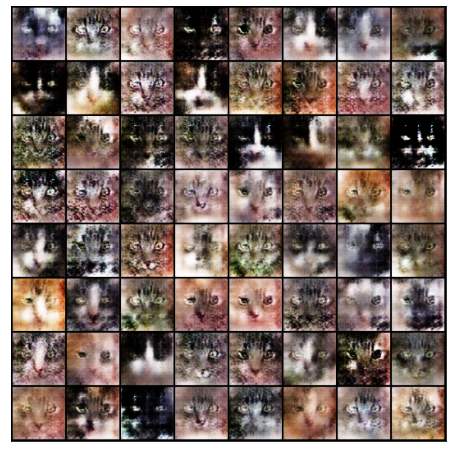


Epoch [10/60], loss_g: 8.6599, loss_d: 1.7305, real_score: 0.9280, fake_score: 0.7477
Saving generated-images-0010.png


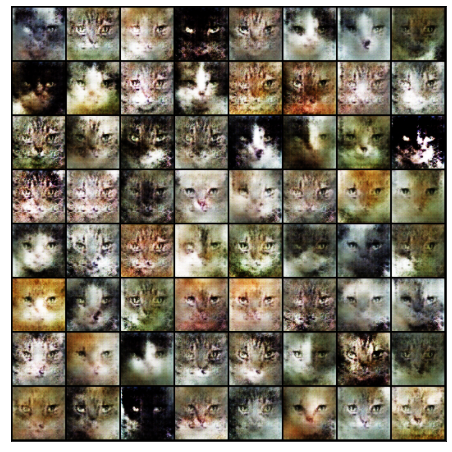


Epoch [11/60], loss_g: 1.7242, loss_d: 0.9205, real_score: 0.4813, fake_score: 0.1167
Saving generated-images-0011.png


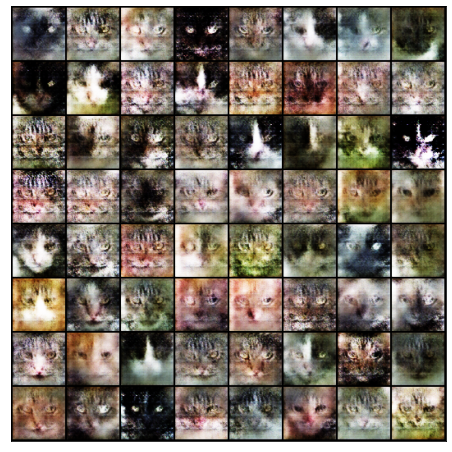


Epoch [12/60], loss_g: 3.7688, loss_d: 0.7082, real_score: 0.7865, fake_score: 0.3370
Saving generated-images-0012.png


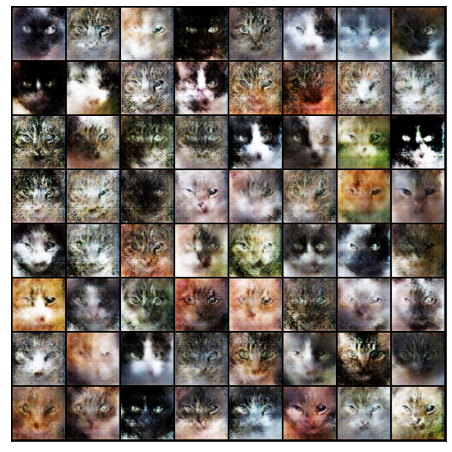


Epoch [13/60], loss_g: 3.5753, loss_d: 0.5067, real_score: 0.8110, fake_score: 0.2233
Saving generated-images-0013.png


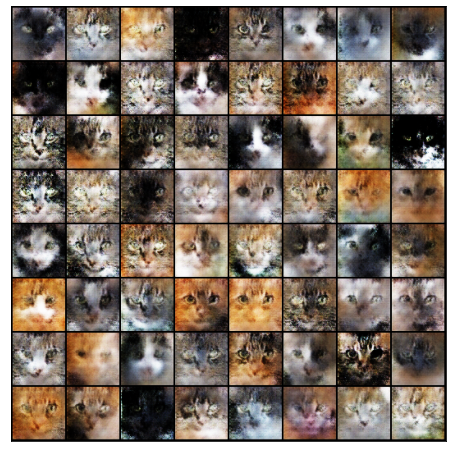


Epoch [14/60], loss_g: 5.2777, loss_d: 0.2867, real_score: 0.9785, fake_score: 0.2163
Saving generated-images-0014.png


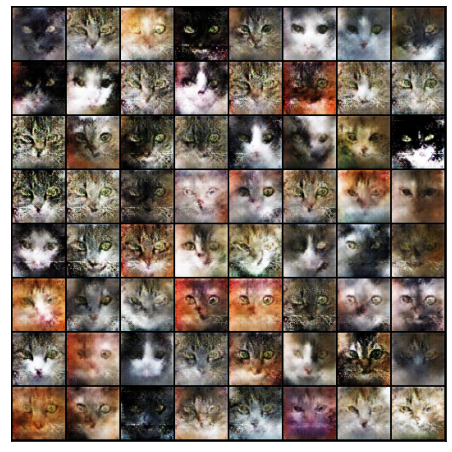


Epoch [15/60], loss_g: 3.9900, loss_d: 0.2022, real_score: 0.9235, fake_score: 0.1094
Saving generated-images-0015.png


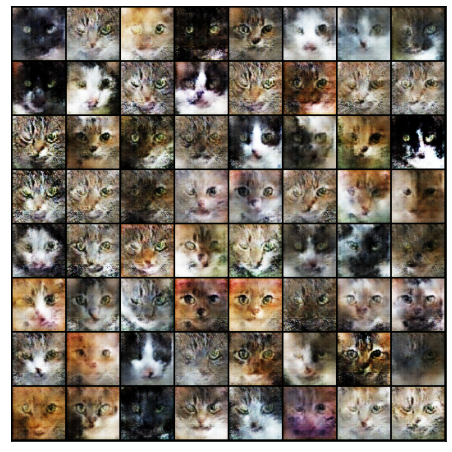


Epoch [16/60], loss_g: 2.0970, loss_d: 0.4305, real_score: 0.7015, fake_score: 0.0272
Saving generated-images-0016.png


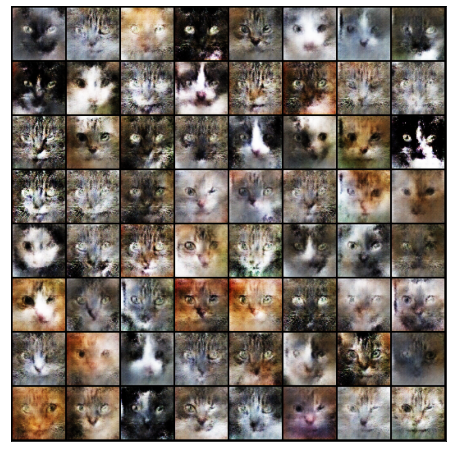


Epoch [17/60], loss_g: 3.0683, loss_d: 0.2811, real_score: 0.8336, fake_score: 0.0841
Saving generated-images-0017.png


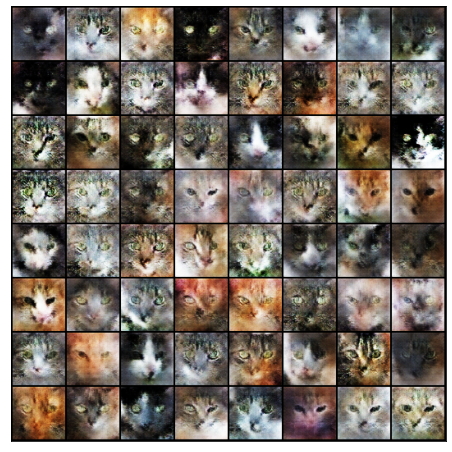


Epoch [18/60], loss_g: 4.1474, loss_d: 0.7090, real_score: 0.9570, fake_score: 0.4326
Saving generated-images-0018.png


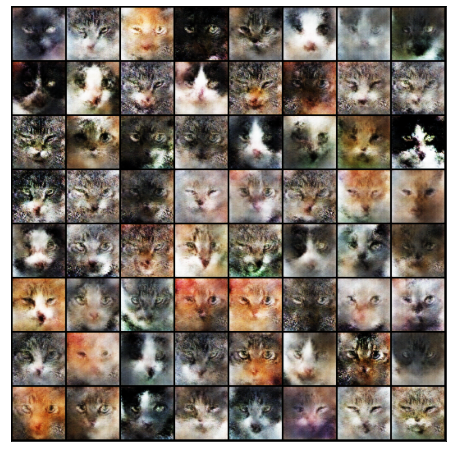


Epoch [19/60], loss_g: 3.5385, loss_d: 0.6739, real_score: 0.5154, fake_score: 0.0107
Saving generated-images-0019.png


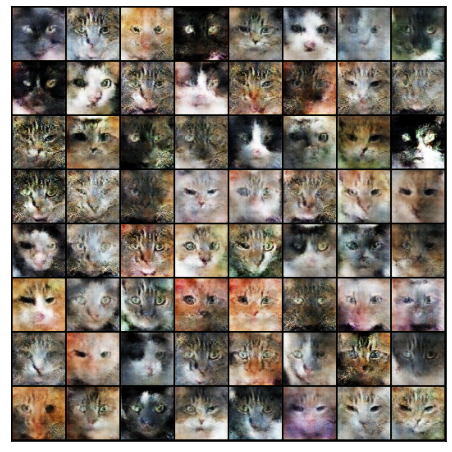


Epoch [20/60], loss_g: 3.4669, loss_d: 1.3873, real_score: 0.3053, fake_score: 0.0027
Saving generated-images-0020.png


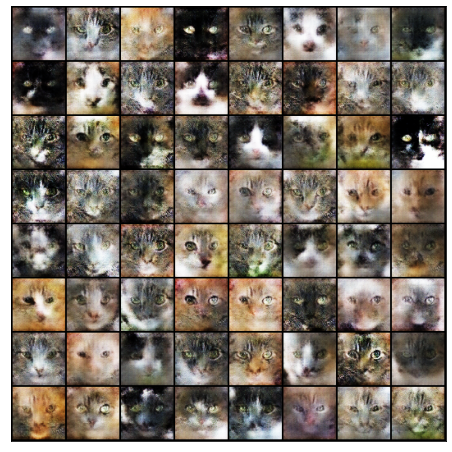


Epoch [21/60], loss_g: 4.1013, loss_d: 0.1776, real_score: 0.8819, fake_score: 0.0396
Saving generated-images-0021.png


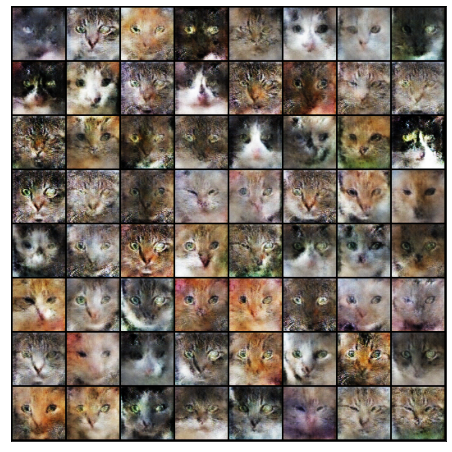


Epoch [22/60], loss_g: 5.8372, loss_d: 0.0186, real_score: 0.9857, fake_score: 0.0041
Saving generated-images-0022.png


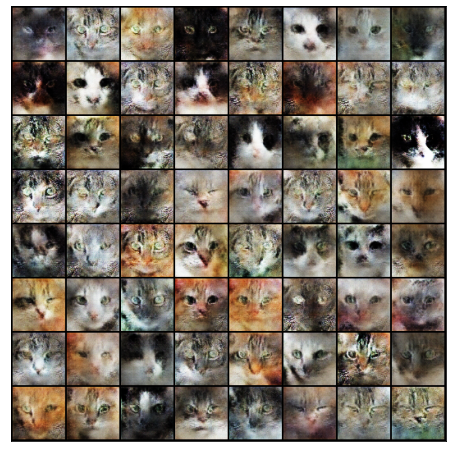


Epoch [23/60], loss_g: 3.0436, loss_d: 0.0616, real_score: 0.9662, fake_score: 0.0261
Saving generated-images-0023.png


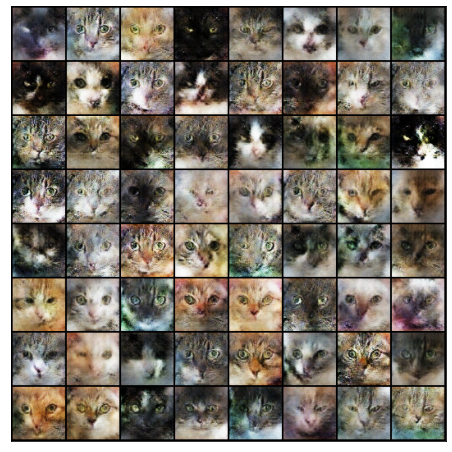


Epoch [24/60], loss_g: 4.9822, loss_d: 0.0589, real_score: 0.9507, fake_score: 0.0079
Saving generated-images-0024.png


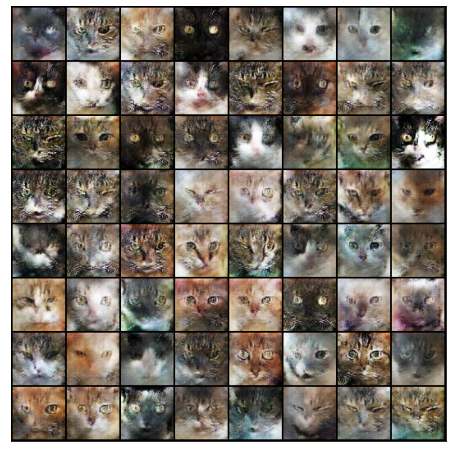


Epoch [25/60], loss_g: 3.6758, loss_d: 0.0480, real_score: 0.9974, fake_score: 0.0415
Saving generated-images-0025.png


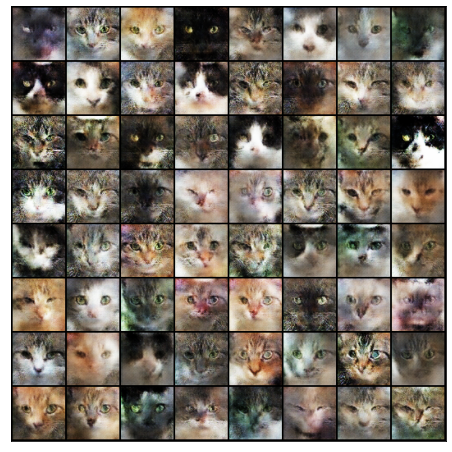


Epoch [26/60], loss_g: 3.8768, loss_d: 0.0556, real_score: 0.9953, fake_score: 0.0481
Saving generated-images-0026.png


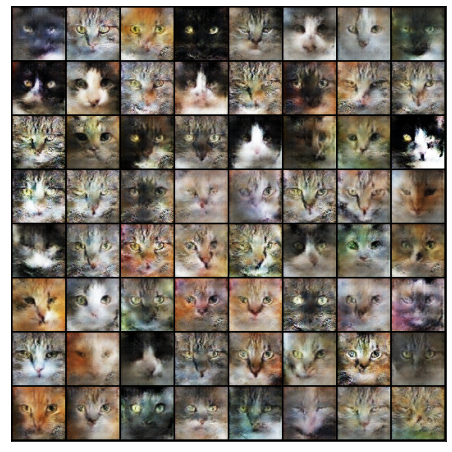


Epoch [27/60], loss_g: 3.4150, loss_d: 0.0844, real_score: 0.9473, fake_score: 0.0287
Saving generated-images-0027.png


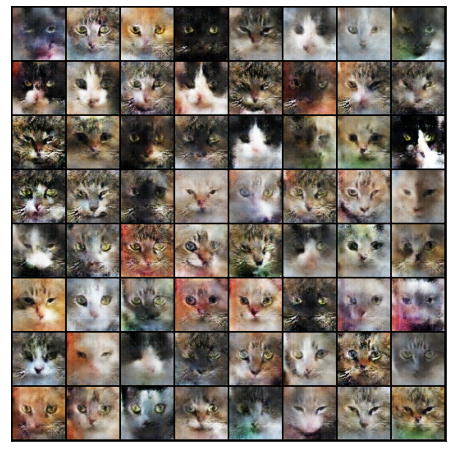


Epoch [28/60], loss_g: 6.5648, loss_d: 0.0665, real_score: 0.9369, fake_score: 0.0009
Saving generated-images-0028.png


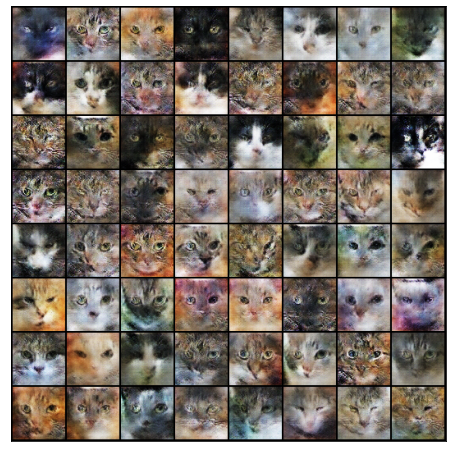


Epoch [29/60], loss_g: 0.6487, loss_d: 0.6173, real_score: 0.5642, fake_score: 0.0375
Saving generated-images-0029.png


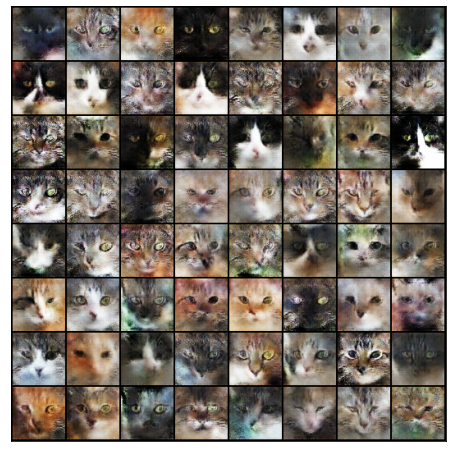


Epoch [30/60], loss_g: 3.8691, loss_d: 0.2696, real_score: 0.8768, fake_score: 0.1160
Saving generated-images-0030.png


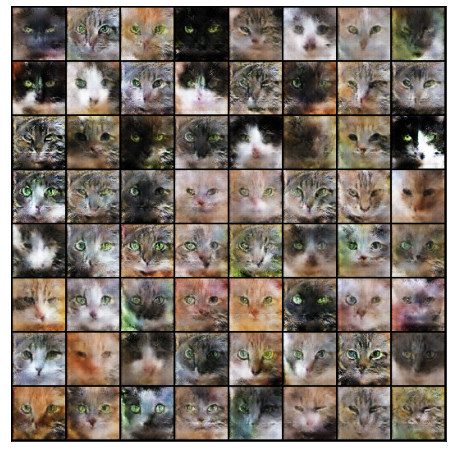


Epoch [31/60], loss_g: 3.9001, loss_d: 0.2370, real_score: 0.8694, fake_score: 0.0801
Saving generated-images-0031.png


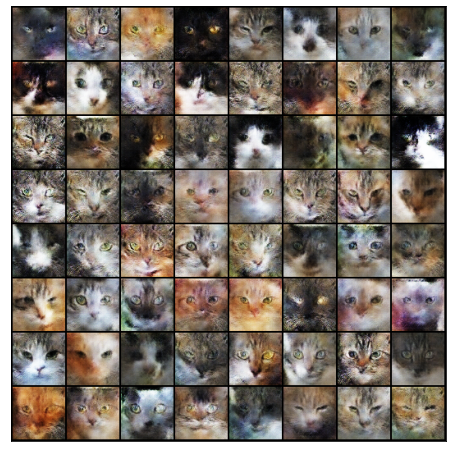


Epoch [32/60], loss_g: 1.3359, loss_d: 1.0391, real_score: 0.3941, fake_score: 0.0166
Saving generated-images-0032.png


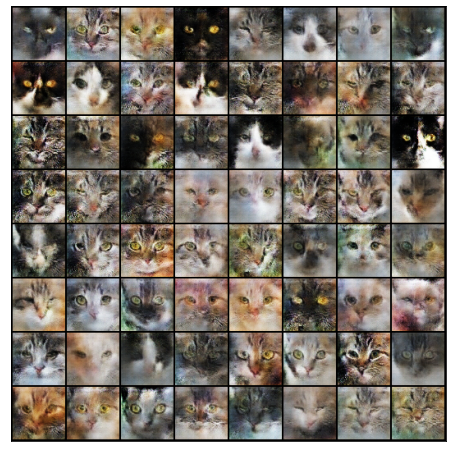


Epoch [33/60], loss_g: 4.7582, loss_d: 0.2185, real_score: 0.9488, fake_score: 0.1417
Saving generated-images-0033.png


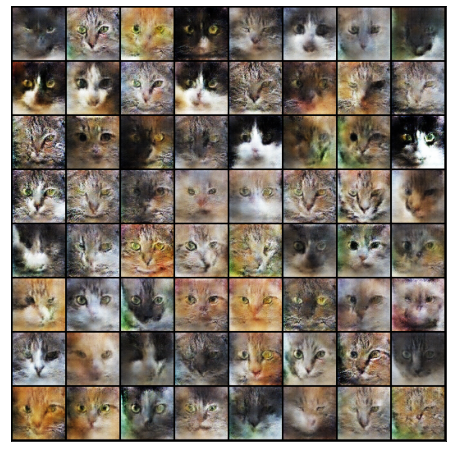


Epoch [34/60], loss_g: 14.8450, loss_d: 1.7055, real_score: 0.9401, fake_score: 0.7580
Saving generated-images-0034.png


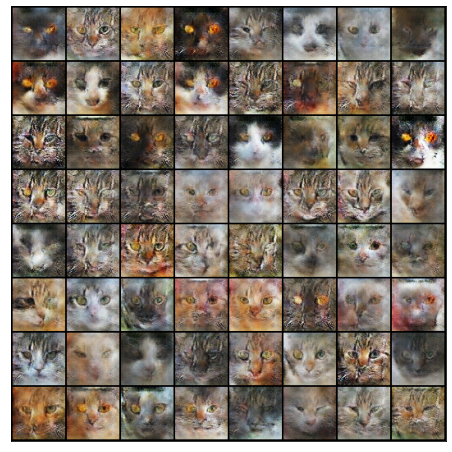


Epoch [35/60], loss_g: 6.2972, loss_d: 0.0153, real_score: 0.9871, fake_score: 0.0023
Saving generated-images-0035.png


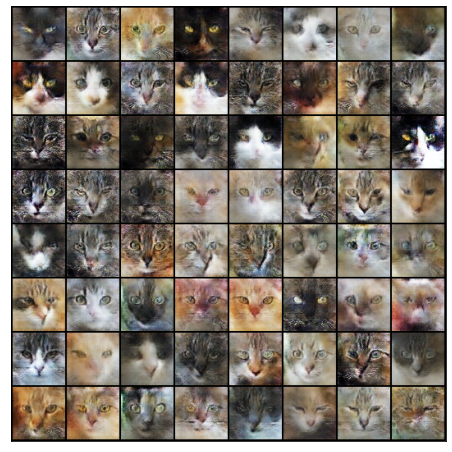


Epoch [36/60], loss_g: 3.2117, loss_d: 1.1620, real_score: 0.5125, fake_score: 0.3256
Saving generated-images-0036.png


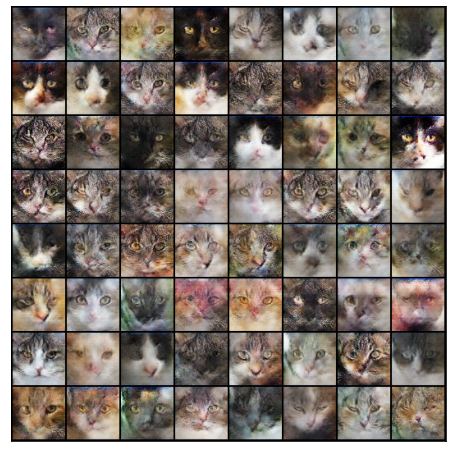


Epoch [37/60], loss_g: 3.7990, loss_d: 0.3604, real_score: 0.7654, fake_score: 0.0088
Saving generated-images-0037.png


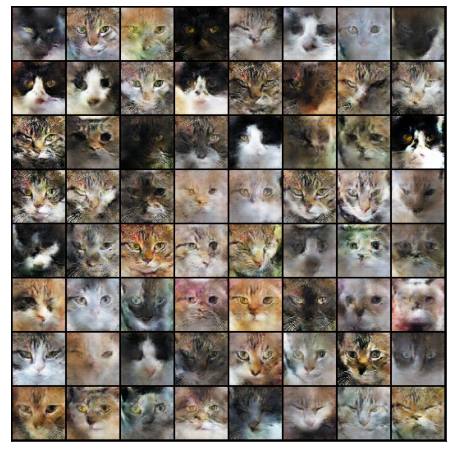


Epoch [38/60], loss_g: 5.0886, loss_d: 0.1629, real_score: 0.9807, fake_score: 0.1272
Saving generated-images-0038.png


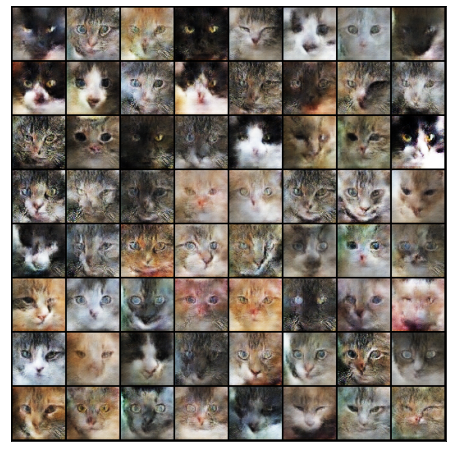


Epoch [39/60], loss_g: 2.3289, loss_d: 0.3207, real_score: 0.8090, fake_score: 0.0549
Saving generated-images-0039.png


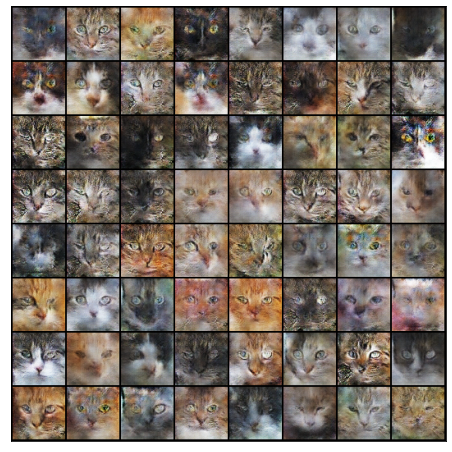


Epoch [40/60], loss_g: 0.9244, loss_d: 0.7051, real_score: 0.5171, fake_score: 0.0205
Saving generated-images-0040.png


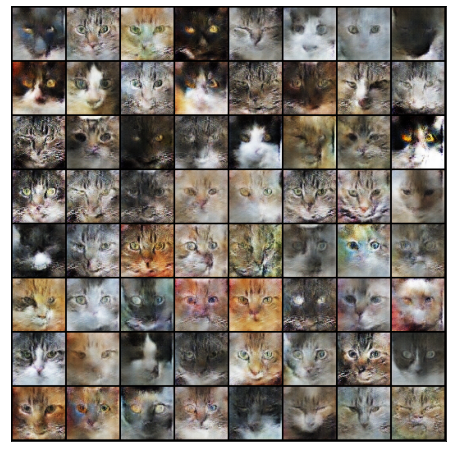


Epoch [41/60], loss_g: 6.7765, loss_d: 0.4488, real_score: 0.9901, fake_score: 0.3202
Saving generated-images-0041.png


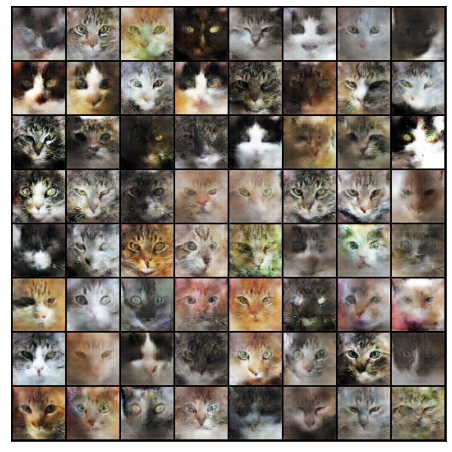


Epoch [42/60], loss_g: 7.1079, loss_d: 0.4367, real_score: 0.6743, fake_score: 0.0007
Saving generated-images-0042.png


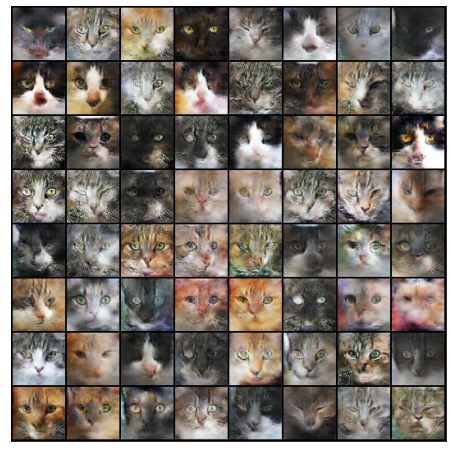


Epoch [43/60], loss_g: 4.6125, loss_d: 0.1744, real_score: 0.9510, fake_score: 0.1091
Saving generated-images-0043.png


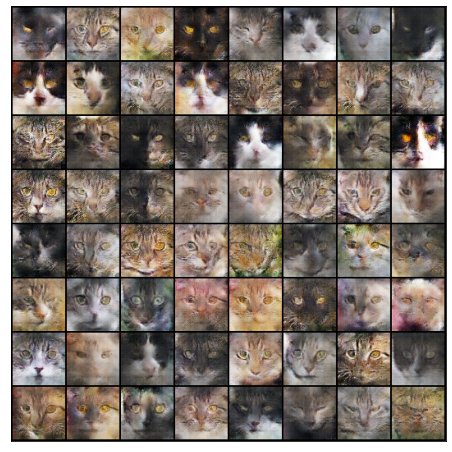


Epoch [44/60], loss_g: 2.3493, loss_d: 0.6079, real_score: 0.6266, fake_score: 0.0059
Saving generated-images-0044.png


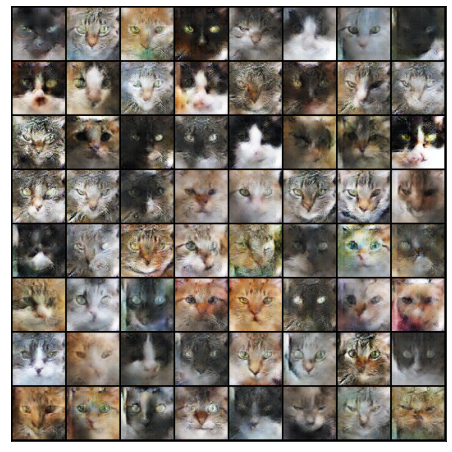


Epoch [45/60], loss_g: 6.2293, loss_d: 0.3855, real_score: 0.9643, fake_score: 0.2576
Saving generated-images-0045.png


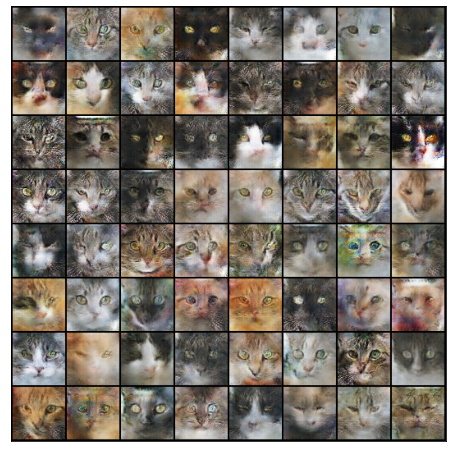


Epoch [46/60], loss_g: 7.0272, loss_d: 0.6593, real_score: 0.5345, fake_score: 0.0005
Saving generated-images-0046.png


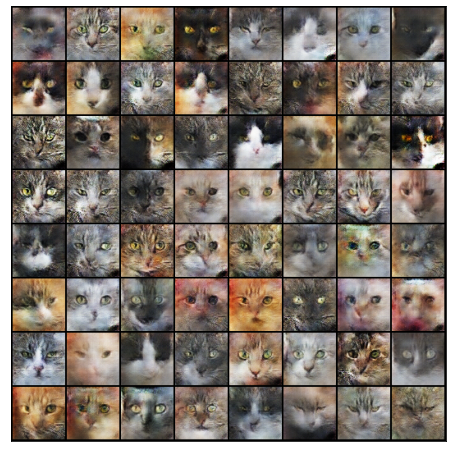


Epoch [47/60], loss_g: 5.5392, loss_d: 0.4223, real_score: 0.6792, fake_score: 0.0001
Saving generated-images-0047.png


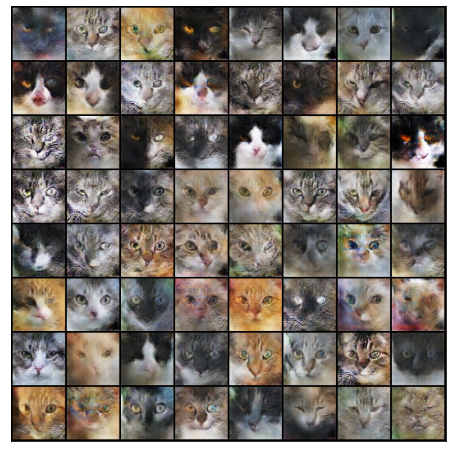


Epoch [48/60], loss_g: 8.5938, loss_d: 0.2611, real_score: 0.7716, fake_score: 0.0001
Saving generated-images-0048.png


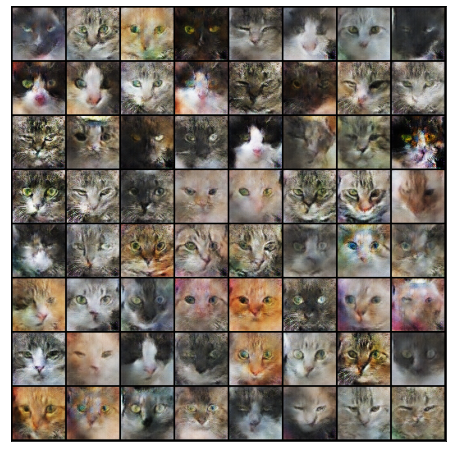


Epoch [49/60], loss_g: 4.6089, loss_d: 0.1222, real_score: 0.9065, fake_score: 0.0170
Saving generated-images-0049.png


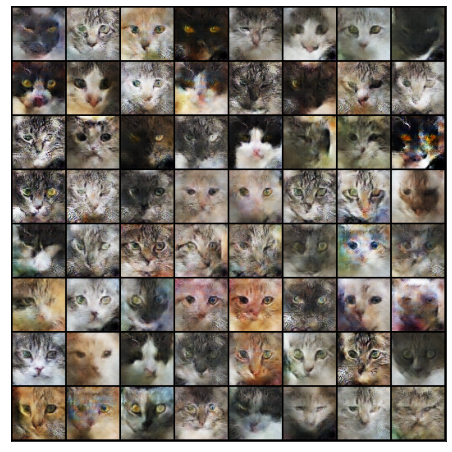


Epoch [50/60], loss_g: 6.9600, loss_d: 0.2017, real_score: 0.9921, fake_score: 0.1509
Saving generated-images-0050.png


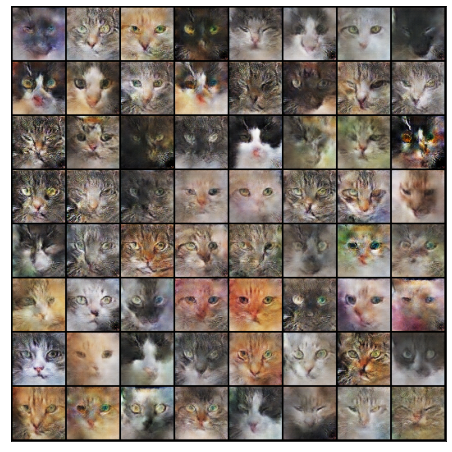


Epoch [51/60], loss_g: 8.6276, loss_d: 0.0155, real_score: 0.9852, fake_score: 0.0004
Saving generated-images-0051.png


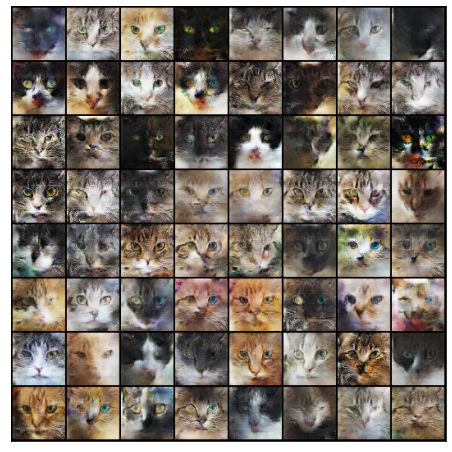


Epoch [52/60], loss_g: 6.3298, loss_d: 0.2250, real_score: 0.8042, fake_score: 0.0014
Saving generated-images-0052.png


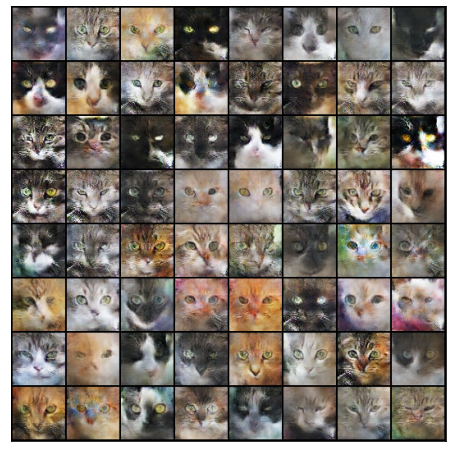


Epoch [53/60], loss_g: 3.5728, loss_d: 0.2163, real_score: 0.8232, fake_score: 0.0109
Saving generated-images-0053.png


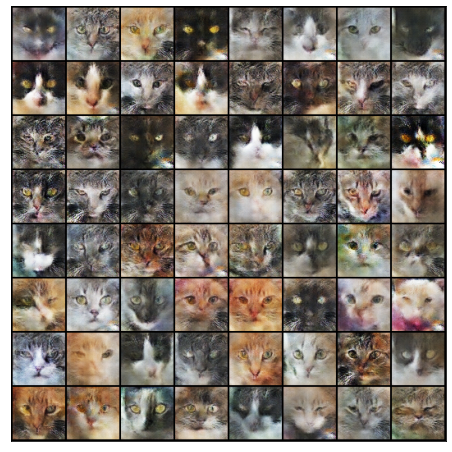


Epoch [54/60], loss_g: 4.2158, loss_d: 0.1181, real_score: 0.9011, fake_score: 0.0125
Saving generated-images-0054.png


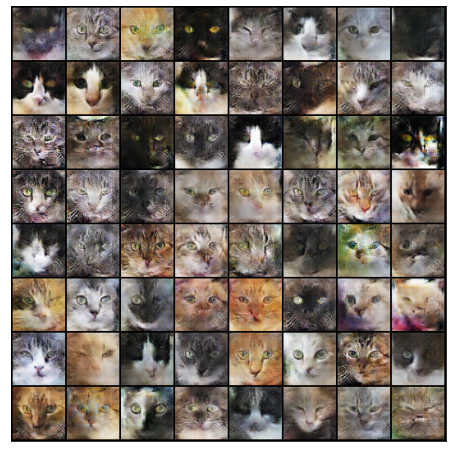


Epoch [55/60], loss_g: 2.7722, loss_d: 0.3709, real_score: 0.7969, fake_score: 0.1168
Saving generated-images-0055.png


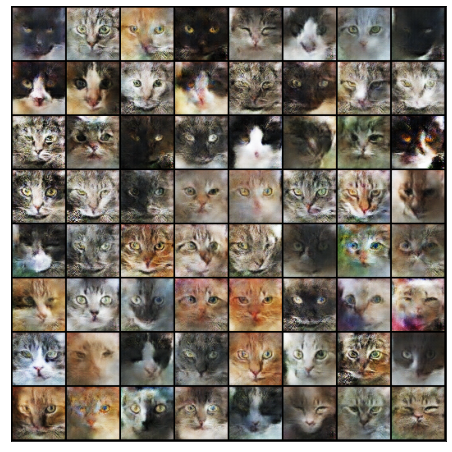


Epoch [56/60], loss_g: 2.6527, loss_d: 1.3447, real_score: 0.5036, fake_score: 0.1507
Saving generated-images-0056.png


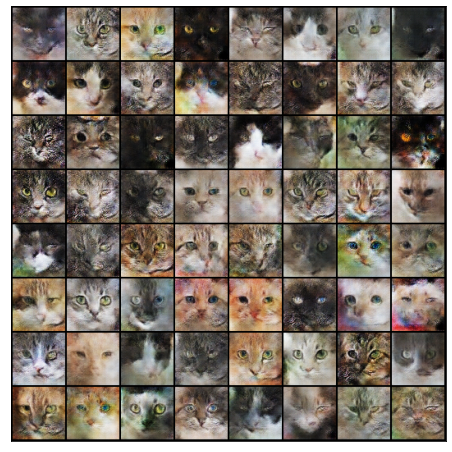


Epoch [57/60], loss_g: 9.3556, loss_d: 0.4399, real_score: 0.9981, fake_score: 0.2768
Saving generated-images-0057.png


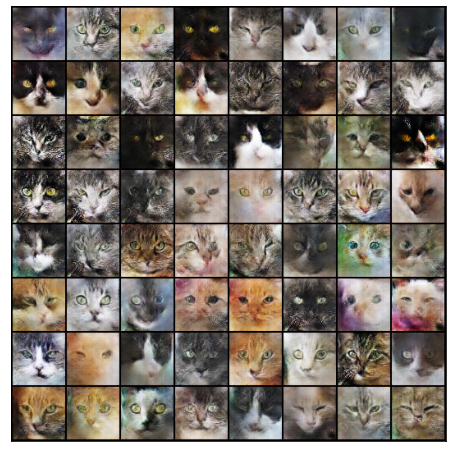


Epoch [58/60], loss_g: 0.3535, loss_d: 0.8073, real_score: 0.5594, fake_score: 0.0222
Saving generated-images-0058.png


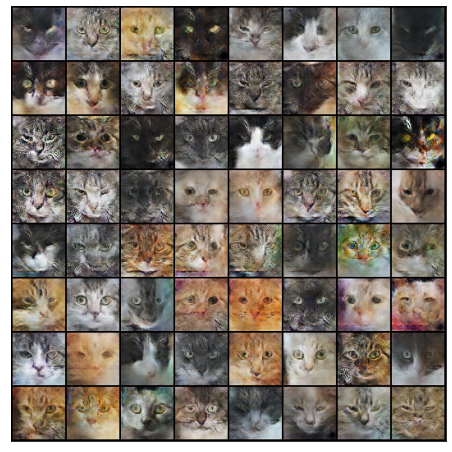


Epoch [59/60], loss_g: 5.2783, loss_d: 0.0382, real_score: 0.9783, fake_score: 0.0159
Saving generated-images-0059.png


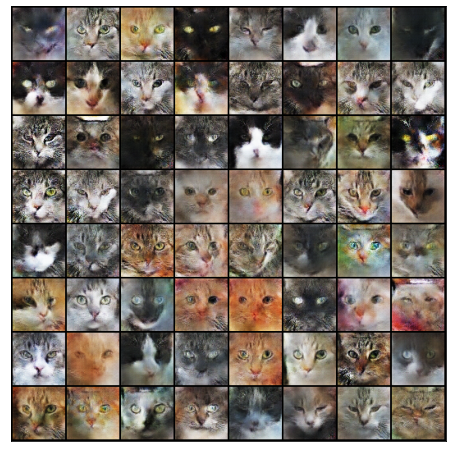


Epoch [60/60], loss_g: 7.3490, loss_d: 0.0210, real_score: 0.9873, fake_score: 0.0079
Saving generated-images-0060.png


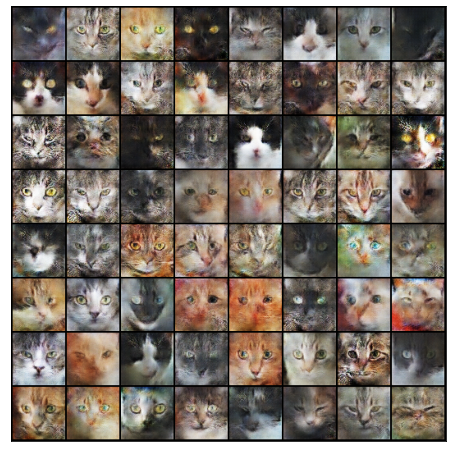

In [ ]:
history = fit(epochs, lr)

In [ ]:
losses_g, losses_d, real_scores, fake_scores = history

In [ ]:
from IPython.display import Image

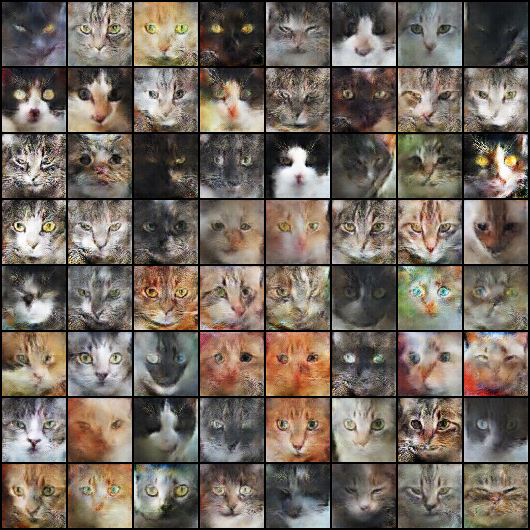

In [ ]:
Image('./generated/generated-images-0060.png')

In [ ]:
vid_fname = 'gans_training.mp4'

files = [os.path.join(sample_dir, f) for f in os.listdir(sample_dir) if 'generated' in f]
files.sort()

out = cv2.VideoWriter(vid_fname,cv2.VideoWriter_fourcc(*'MP4V'), 1, (530,530))
[out.write(cv2.imread(fname)) for fname in files]
out.release()

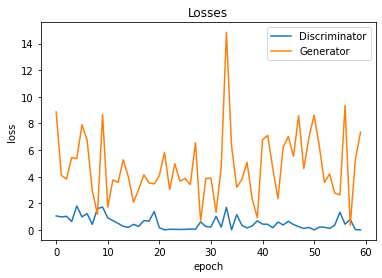

In [ ]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

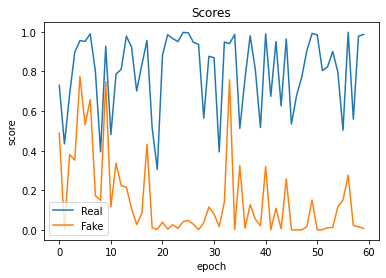

In [ ]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

# TO DO

## Improve GAN's behaviour. (8 баллов)


1. Try to add more Conv-BN blocks in Discriminator
2. Try to add Pooling to Discriminator
3. Try to add more Conv-BN blocks in Generator
4. Increase `latent_size`
5. Try use ELU or LeakyReLU

For more tips on improving GAN's stability you can check this [source](https://machinelearningmastery.com/how-to-train-stable-generative-adversarial-networks/)

Для получения баллов используйте как минимум 2 tips&tricks из статьи. Укажите в комментарии, что именно вы улучшили.

## Generate Fake Faces! (4 балла)


1. Add CenterCrop transformation to images and reduce their size
2. Use deeper GAN model
3. Obtain model that produce reasonably good faces ("resembling a car crash victim" or better)


In [5]:
!wget http://vis-www.cs.umass.edu/lfw/lfw-deepfunneled.tgz -O tmp.tgz

--2021-05-05 06:10:22--  http://vis-www.cs.umass.edu/lfw/lfw-deepfunneled.tgz
Resolving vis-www.cs.umass.edu (vis-www.cs.umass.edu)... 128.119.244.95
Connecting to vis-www.cs.umass.edu (vis-www.cs.umass.edu)|128.119.244.95|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 108761145 (104M) [application/x-gzip]
Saving to: ‘tmp.tgz’

tmp.tgz             100%[===================>] 103.72M  15.3MB/s    in 8.1s    

2021-05-05 06:10:31 (12.7 MB/s) - ‘tmp.tgz’ saved [108761145/108761145]



In [6]:
!tar xvzf tmp.tgz && rm tmp.tgz

Выходные данные были обрезаны до нескольких последних строк (5000).
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0012.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0013.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0014.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0015.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0016.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0017.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0018.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0019.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0020.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0021.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0022.jpg
lfw-deepfunneled/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0023.

In [7]:
DATA_DIR = './lfw-deepfunneled/'
image_size = 250
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
image_size = 64
batch_size = 128

In [14]:
train_ds = ImageFolder(DATA_DIR, transform=tt.Compose([tt.ToTensor(), tt.CenterCrop(image_size), tt.Normalize(*stats)]))